# LINEARNA REGRESIJA

Analiza __linearne regresije__ se koristi kako bi se predvidela vrednost promenljive u zavisnosti od vrednosti druge promenljive. Promenljiva koju želimo da predvidimo se naziva __zavisna promenljiva__, a promenljiva koju koristimo da bi predvideli vrednost zavisne promenljive naziva se __nezavisna promenljiva__.<br>
Ovaj oblik analize procenjuje koeficijente linearne jednačine, uključujući jednu ili više nezavisnih promenljivih u predviđanju zavisne promenljive. 


## Zašto je linearna regresija bitna?

Modeli linearne regresije su relativno jednostavni i jednostavni za interpretiranje matematičkih formula koje mogu generisati predviđanja. Linearne regresije se mogu koristiti u raznim poslovnim i akademskim oblastima.<br><br>
___"Modeli linearne regresije su postali dokazani načini za naučno i pouzdano predviđanje budućnosti."___

## Primer

Učitavanje potrebnih biblioteka:
* __torch(Pytorch)__ glavna biblioteka 
* __torch.nn__ "torch neural network" biblioteka za rad sa neuralnim mrežama
* __numpy__ za manipulaciju podataka
* modul __datasets__ iz biblioteke __sklearn__ za kreiranje regresivnog skupa podataka
* __matplotlib.pyplot__ za crtanje grafika

In [1]:
import torch
import torch.nn as nn
import numpy as np
from sklearn import datasets
import matplotlib.pyplot as plt

Koraci u kreiranju linearne regresije:
1. Priprema podataka
2. Kreiranje __modela__
3. Računanje __greške__ i __optimizacija__ (eng. loss and optimizer)
* __greška__ je u stvari razlika između predviđene vrednosti i stvarne vrednosti
* __optimizacija__ se koristi kako bi se __greška__ smanjila što je više moguće
4. Proces same obrada podataka "treninga".
* Može se na podeliti u tri faze
    1. Na engleskom se najčešće naziva "forward pass" u kojem se izračunaju predikcije i greške
    2. Na engleskom se najčešće naziva "backward pass" u kojem se računa nagib
    3. Na engleskom se najčešće naziva "update weights" u kojem se ažuriraju težine

1. Priprema podataka

In [2]:
X_numpy, y_numpy = datasets.make_regression(n_samples = 100, n_features = 1, noise = 20, random_state = 1)

Moramo pretvoriti podatke u tensor sa podacima tipa _float_

In [3]:
X = torch.from_numpy(X_numpy.astype(np.float32))
y = torch.from_numpy(y_numpy.astype(np.float32))

Moramo pretvoriti sada podatke u tensoru _y_ tako da su u jednoj koloni. Sačuvaćemo i potrebne podatke o uzorcima u promenljivama <em>n_samples</em> i <em>n_features</em>.

In [4]:
y = y.view(y.shape[0], 1)
n_samples, n_features = X.shape

2. Kreiranje modela <br>
* U linearnoj regresiji nam je dovoljan samo 1 sloj (layer).
* Za kreiranje samog modela koristićemo funkciju __Linear()__ iz modula _nn_ iz biblioteke _torch_.

In [5]:
input_size = n_features
output_size = 1 #samo jedan izlazni podatak za svaki uzorak(sample)
model = nn.Linear(input_size, output_size)

3. Greška i optimizacija
* Za procenu greške koristićemo funkciju __MSELoss__ (od "Mean Square Error") iz modula _nn_ iz _torch_ biblioteke.
* Optimizaciju ćemo raditi pomoću funkcije __SGD()__ (od "Stochastic Gradient Descent (SGD)") iz biblioteke _torch_.
* __Learning rate__ je jako bitan faktor. Ukoliko se uzme premala vrednost, konvergencija će biti veoma spora, ipak ukoliko se uzme prevelika vrednost može doći do prevelike greške u proceni vrednosti. Vrednost 0.01 koju mi ovde koristimo je dovoljna za ovakav model.

In [6]:
lossCalc = nn.MSELoss()
learning_rate = 0.01
optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate)

4. Proces treninga (rad samog modela koji smo kreirali)
* Definisaćemo broj koliko puta želimo da radimo iteracije <em>num_epoch</em>.
* <em>y_predicted</em> je promenljiva u koju ćemo smeštati tensor sa predviđenim vrednostima.
* Greške ćemo takođe dobiti u vidu tensora koji vraća funkcija __MSELoss()__ i smeštati u promenljivu _loss_.
* Funkcija __backward()__ računa koeficijent nagiba.
* __Optimizer.step()__ će ažurirati težine.
* Kako bi se pripremili za sledeću iteraciju moramo odraditi __optimizer.zero_grad()__ .

In [7]:
num_epochs = 100
for epoch in range(num_epochs):
    y_predicted = model(X)
    loss = lossCalc(y_predicted, y)
   
    loss.backward()
    
    optimizer.step()
    
    optimizer.zero_grad()

__Iscrtavanje rezultata__<br>
Rezulate ćemo crtati pomoću biblioteke __matplotlib__

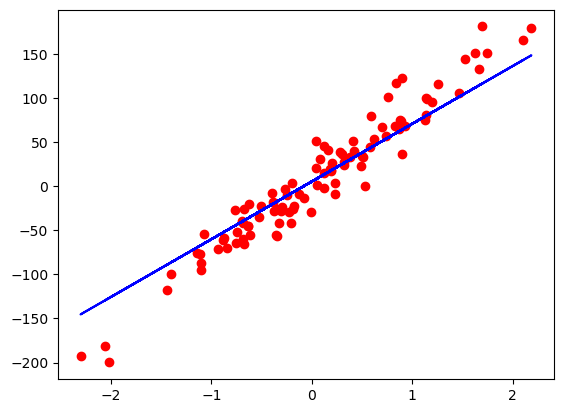

In [8]:
predicted = model(X).detach().numpy()
plt.plot(X_numpy, y_numpy, "ro")
plt.plot(X_numpy, predicted, "b")
plt.show()

# OBRADA SLIKA 

## PREPOZNAVANJE OBJEKATA NA SLIKAMA POMOĆU __RESNET__

Par reči o mreži i skupu podataka koji ćemo koristiti:
* Rezidualna mreža koju ćemo koristiti je _trenirana_ mreža ___ResNet___ .
* Kroz vreme istraživači su videli da dodavanje novih slojeva u neuralne mreže poboljšavalo karakteristike, međutim samo do određenih granica. Upravo tako nastala potreba za nadogradnjom i predstavljene su __rezidualne mreže__.
* ___Resnet___ je 2015. godine osvojio nagradu za prepoznavanje slika sa procentom greške od 3.57% .
* __"Trenirana" (eng. "pretrained network")__ znači da je već testirana i "naučena" kako da obradi podatke. 
* Trenirana mreža koju ćemo koristiti je trenirana na _"ImageNet"_ skupu podataka(slika) (http://imagenet.stanford.edu).
* _ImageNet_ je baza sa više od 14 miliona slika koju održava _Stanford University_.

__Koraci u procesu prepoznavanja objekta na slici:__
1. Učitavanje slike.
2. Obrada slike za proces prepoznavanja (promene veličine, sečenje, pretvaranje u tensor,...).
3. Prolazak kroz samu mrežu i obrada sa već "treniranim težinama" .
4. Po izlasku iz obrade formira se tensor koji ukazuje na to koji je objekat.
5. Po tensoru se iz spiska objekata (kategorije.txt) koje je moguće prepoznati sa ovom mrežom dobija konkretan odgovor koji objekat je na slici.

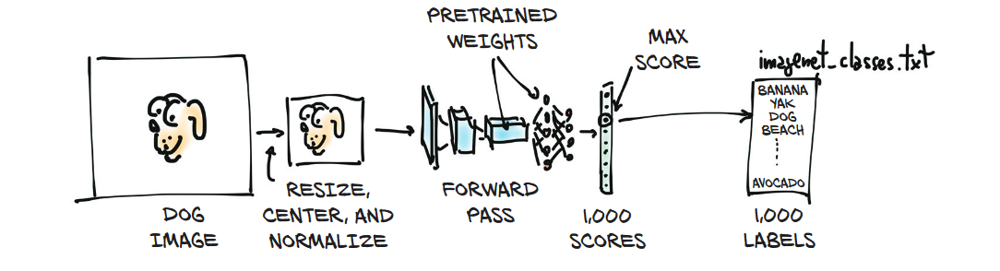

Učitavanje potrebnih biblioteka:

* Biblioteka __torch__ je glavna biblioteka.
* Biblioteka __torchvision__ za učitavanje potrebnog modela __ResNet__ i učitavanje potrebnih funkcija (Compose()) za pripremu slika za obradu.
* Biblioteka __pillow(PIL)__ za rad sa slikama.
* Biblioteka __urllib__ iz koje ćemo koristiti modul __request__ za lakše učitavanje potrebnih slika (kako ih ne bismo morali preuzimati pa ubacivati)

In [9]:
from torchvision import models 
from torchvision import transforms 
from PIL import Image 
import urllib.request 
import torch 

Kreiraćemo instancu mreže sa već predefinisanim __težinama__ (koje su dodeljene upravo po bazi slika koje ćemo ovde koristiti):

In [10]:
resnet = models.resnet101(weights = True) #ovaj deo koda prikazuje upozorenje da je zastareo ali druga rešenja takođe nisu optimalna

C:\Users\Ridji\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Osvrt na to šta se nalazi ustvari u _resnet_ promenljivoj: (deo koda u liniji ispod nije obavezan za sam rad modela, već je tu samo kako bi videli šta se zapravo nalazi u promenljivoj _resnet_)
* Dakle vidimo različite slojeve(layer-e).
* ResNet101 upravo označava da postoji 101 sloj (misli se zajedno na "layers" i "bottleneck").
* To su zapravo blokovi koji karakterišu rezidualne mreže.

In [11]:
resnet 

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

Učitavanje potrebnih slika:
* biblioteka __urllib.request__ je tu samo da olakša učitavanje slika (kako se ne bi morale preuzimati pa uploadovati)
* __Image.open()__ funkcija za učitavanje slike

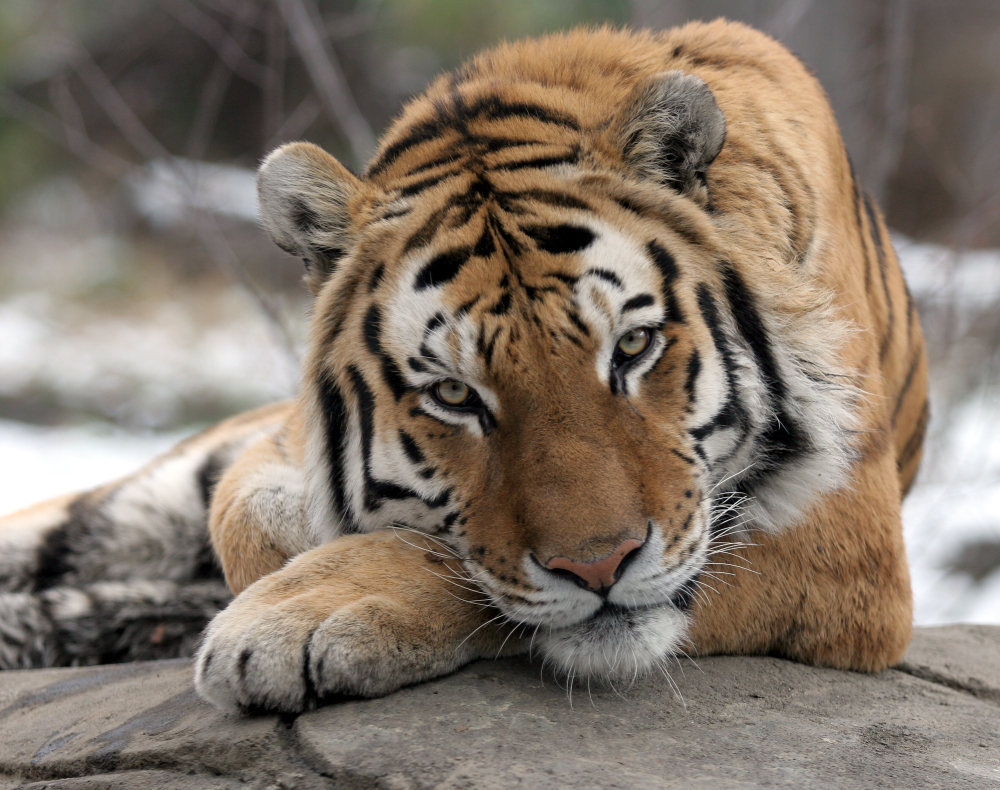

In [ ]:
urllib.request.urlretrieve("ENTER URL HERE", 
                           "tigarIzUrl.jpg")
img1 = Image.open("tigarIzUrl.jpg")
img1

Funkcija __preprocess()__ koja priprema slike za obradu (menja veličinu slike, vrši sečenje, pretvara u tensor...)

In [13]:
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)])

Dakle, nad slikom se poziva funkcija _preprocess()_ koja vraća __tensor__ za tu sliku.

In [14]:
img_t1 = preprocess(img1)

Sada, nad tim tensorom poziva se funkcija _unsqueeze()_ kako bi ga još više obradila i dovela u oblik kakav mreža očekuje da primi.

In [15]:
batch_t1 = torch.unsqueeze(img_t1, 0)

Postupak obrade podatka nad treniranom mrežom naziva se __"zaključak (eng. "inference")__.<br>
Da bi odradili "zaključak" moramo prebaciti mrežu u ___eval___ mod.

In [16]:
resnet.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

Sledi sama obrada i dodela obrađenog podatka promenljivoj _out1_.<br>
Sama obrada će odraditi __44.5__ miliona operacija.

In [17]:
out1 = resnet(batch_t1)

In [18]:
out1

tensor([[-2.3376e+00, -2.0001e+00, -5.5794e-01, -1.9602e+00, -2.1966e+00,
         -3.7243e+00, -3.7084e+00,  1.6031e-01,  7.6041e-01, -1.3129e+00,
          2.2496e+00, -9.4078e-01, -7.6165e-01, -4.8022e-01, -1.0589e+00,
         -1.1256e-01, -2.0927e+00, -2.5073e-01, -2.6857e+00, -2.3067e+00,
         -5.3414e-01, -1.1818e+00, -1.9947e+00, -6.2568e-02,  2.8866e-01,
         -1.5000e+00, -1.4857e+00, -2.1637e+00, -4.6481e-01, -2.2824e+00,
         -4.0671e-01, -2.0188e+00, -3.0954e-01, -1.0256e+00,  8.8821e-01,
          4.3377e-01,  1.7992e+00, -4.3142e-01,  7.5191e-01,  1.4536e+00,
         -1.5311e+00,  3.0642e+00, -5.4105e-01,  1.3050e-01, -1.8394e-01,
          9.8679e-01,  7.7378e-02, -2.1360e+00, -3.6388e-01,  6.2553e-01,
         -4.1786e-01, -7.1031e-01,  9.0542e-01,  1.1567e+00, -7.0995e-01,
         -1.7697e+00,  1.6260e+00, -1.3004e+00, -3.2478e-01,  7.8266e-02,
          1.2598e+00,  1.3210e-01,  2.1565e+00,  7.6311e-01, -6.8762e-01,
         -1.7884e+00,  1.0584e+00,  6.

Prikaz promenljive _out1_ nam pokazuje da je gotov podatak ustvari tensor sa određenim vrednostima.

Ispod se nalazi otvaranje fajla koji u sebi sadrži sve nazive kategorija na kojima je mreža trenirana.

In [19]:
with open("kategorije.txt") as f:
    labels = [line.strip() for line in f.readlines()]

Sada, moramo naći indeks koji se odnosi na maksimalnu vrednost u tensoru _out1_ koji smo obradili.

In [20]:
_, index1 = torch.max(out1, 1)
index1

tensor([292])

* Međutim, kao što se vidi gore taj indeks nije broj već takođe neki tensor koji nam ukazuje na objekat koji je na slici.<br>
* Da bi dobili konkretan broj potrebno je uzeti prvu vrednost iz tog tensora, odnosno index1[0]. <br>
* Takođe, pomoću funkcije _softmax()_ možemo videti i sa kojim procentom je mreža "sigurna" da je dala tačan odgovor šta je na slici

In [21]:
percentage = torch.nn.functional.softmax(out1, dim=1)[0] * 100
labels[index1[0]], percentage[index1[0]].item()

('tiger, Panthera tigris', 77.44589233398438)

<div class="alert alert-block alert-success">
    Dobili smo odgovor kao što smo očekivali, dakle na slici je <b>tigar</b>, procenat da je podatak dobar je <b>77.44%</b>.
</div>

## MODIFIKOVANJE SLIKA (PROMENA KONJA U ZEBRU)

Uvodni pojmovi i šta ćemo koristiti:
* __CycleGAN__ mrežu u kombinaciji sa ResNet mrežom.
* Sufiks _GAN_ označava "generativna suparnička mreža" (eng. "generative adversarial network"), gde _generativna_ znači da se nešto kreira (u ovom slučaju lažna slika), _suparnička_ da se dve mreže takmiče koja će da nadmudri drugu i _mreža_ je očigledno.
* __CycleGAN__ mreža je takođe trenirana na ImageNet bazi slika.
* Dakle, mreža radi tako što uzme sliku na kojoj je konj, pretvori konja u zebru, dok se trudi da ostatak slike ostane što više nepromenjen.
* Zbog prevelikog razvoja ovakvih tehnologija, veruje se da u budućnosti nećemo moći da razdvojimo stvarno od lažnog čak ni u video snimku koji se prenosi uživo.

__Koncept rada mreže__ <br>
Najprostije rečeno, mreža uzima sliku, analizira piksel po piksel i detektuje jednog ili više konja. Kada su konji detektovani, mreža obradi sliku.

Klase _ResNetBlock_ i _ResNetGenerator_ koje će nam biti potrebne

In [22]:
import torch
import torch.nn as nn

class ResNetBlock(nn.Module): # <1>

    def __init__(self, dim):
        super(ResNetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim)

    def build_conv_block(self, dim):
        conv_block = []

        conv_block += [nn.ReflectionPad2d(1)]

        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=0, bias=True),
                       nn.InstanceNorm2d(dim),
                       nn.ReLU(True)]

        conv_block += [nn.ReflectionPad2d(1)]

        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=0, bias=True),
                       nn.InstanceNorm2d(dim)]

        return nn.Sequential(*conv_block)

    def forward(self, x):
        out = x + self.conv_block(x) # <2>
        return out


class ResNetGenerator(nn.Module):

    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=9): # <3> 

        assert(n_blocks >= 0)
        super(ResNetGenerator, self).__init__()

        self.input_nc = input_nc
        self.output_nc = output_nc
        self.ngf = ngf

        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=True),
                 nn.InstanceNorm2d(ngf),
                 nn.ReLU(True)]

        n_downsampling = 2
        for i in range(n_downsampling):
            mult = 2**i
            model += [nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3,
                                stride=2, padding=1, bias=True),
                      nn.InstanceNorm2d(ngf * mult * 2),
                      nn.ReLU(True)]

        mult = 2**n_downsampling
        for i in range(n_blocks):
            model += [ResNetBlock(ngf * mult)]

        for i in range(n_downsampling):
            mult = 2**(n_downsampling - i)
            model += [nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2),
                                         kernel_size=3, stride=2,
                                         padding=1, output_padding=1,
                                         bias=True),
                      nn.InstanceNorm2d(int(ngf * mult / 2)),
                      nn.ReLU(True)]

        model += [nn.ReflectionPad2d(3)]
        model += [nn.Conv2d(ngf, output_nc, kernel_size=7, padding=0)]
        model += [nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, input): # <3>
        return self.model(input)

Sada, kreirajmo objekat klase _ResNetGenerator_

In [23]:
netG = ResNetGenerator()

Kada ovako napravimo objekat, težine nam nisu učitane, dakle trebamo ih učitati, a za to nam je potreban fajl _horse2zebra_0.4.0.pth_

In [24]:
model_path = "horse2zebra_0.4.0.pth"
model_data = torch.load(model_path)
netG.load_state_dict(model_data)

<All keys matched successfully>

Prebacimo mrežu u _eval_ mod.

In [25]:
netG.eval()

ResNetGenerator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (9): ReLU(inplace=True)
    (10): ResNetBlock(
      (conv_block): Sequential(
        (0): ReflectionPad2d((1, 1, 1, 1))
        (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
        (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
        (3): ReLU(inplace=True)
        (4): ReflectionPad2d((1, 1, 1, 1))
     

Dalje, posao je vrlo sličan kao u prethodnom primeru. <br>
Opet pravimo funkciju _preprocess_ koja je prva faza pripreme slike za obradu.

In [26]:
preprocess2 = transforms.Compose([transforms.Resize(256), transforms.ToTensor()])

Učitavamo sliku...

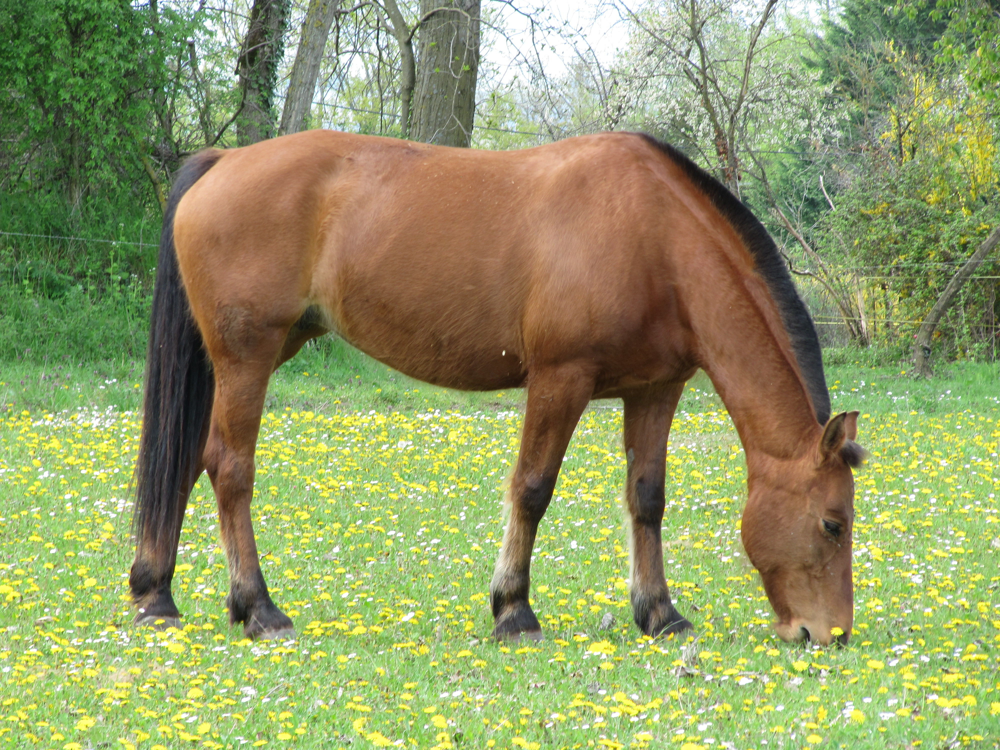

In [27]:
urllib.request.urlretrieve("https://external-content.duckduckgo.com/iu/?u=http%3A%2F%2Fcoyotus.net%2Ffiles%2Fhorse-4_1.jpg&f=1&nofb=1&ipt=42becbb22d819cee28a77f32d5a3e8971ba37dc3783263c025b33be094efb31b&ipo=images", 
                           "horse.jpg")
img2 = Image.open("horse.jpg")
img2

Dalja obrada kao u prethodnom primeru...

In [28]:
img_t2 = preprocess2(img2)
batch_t2 = torch.unsqueeze(img_t2, 0)

Sada, podatak je spreman za obradu u mreži.

In [29]:
batch_out2 = netG(batch_t2)

Slika je obrađena i spremna za prikaz.

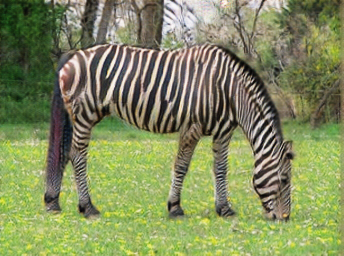

In [30]:
out_t2 = (batch_out2.data.squeeze() + 1.0) / 2.0
out_img = transforms.ToPILImage()(out_t2)
#out_img.save('') ukoliko želimo da sačuvamo sliku
out_img

<div class="alert alert-block alert-success">
    <b>Slika je uspešno obrađena!</b>
</div>

# Napomene 

## Biblioteke

Verzije biblioteka koje su korišćene su sve standradne verzije koje se mogu instalirati direktno kroz _Anaconda_ okruženje, osim biblioteke _torchvision_ koja se mora instalirati najnovija verzija u kojoj su dodate novije funkcije i otklonjeni određeni nedostaci. Okruženje _Anaconda_ ne nudi instalaciju najnovije verzije, pa se mora instalirati direktno kroz komandnu liniju (__"Anaconda Prompt (anaconda3)"__). Prvo je potrebno obrisati sve prethodne verzije koje su instalirane, a onda instrukcijom
"conda install -c pytorch torchvision="0.14.0" "instalirati najnoviju verziju torchvision-a. Standrdnom instalacijom kroz okruženje instalira se torchvision 0.2.2 koji nije optimalan za rad sa svim funkcijama koje su potrebne.